## Importing Libraries

In [342]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import scipy
import os
import pickle
import librosa
import librosa.display
from IPython.display import Audio
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
import tensorflow as tf
from tensorflow import keras
import math
from sklearn import preprocessing


In [343]:
print("Num of GPUs available: ", len(tf.compat.v1.config.list_physical_devices("GPU")))

Num of GPUs available:  1


In [344]:
df = pd.read_csv("gtzan/features_3_sec.csv")
df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [345]:
df.shape

(9990, 60)

In [346]:
df.dtypes

filename                    object
length                       int64
chroma_stft_mean           float64
chroma_stft_var            float64
rms_mean                   float64
rms_var                    float64
spectral_centroid_mean     float64
spectral_centroid_var      float64
spectral_bandwidth_mean    float64
spectral_bandwidth_var     float64
rolloff_mean               float64
rolloff_var                float64
zero_crossing_rate_mean    float64
zero_crossing_rate_var     float64
harmony_mean               float64
harmony_var                float64
perceptr_mean              float64
perceptr_var               float64
tempo                      float64
mfcc1_mean                 float64
mfcc1_var                  float64
mfcc2_mean                 float64
mfcc2_var                  float64
mfcc3_mean                 float64
mfcc3_var                  float64
mfcc4_mean                 float64
mfcc4_var                  float64
mfcc5_mean                 float64
mfcc5_var           

In [347]:
df_with_filename = df
df=df.drop(labels="filename",axis=1)

## Feature Extraction
Кодируем метку цифрами, т к она изначально представлена строкой.

In [348]:
class_list=df.iloc[:,-1]
converter=LabelEncoder()


In [349]:
# y=converter.fit_transform(class_list)
converter.fit(class_list)
Y=converter.transform(class_list)
print(class_list)
print(Y)
print(list(converter.inverse_transform(Y)))

0       blues
1       blues
2       blues
3       blues
4       blues
        ...  
9985     rock
9986     rock
9987     rock
9988     rock
9989     rock
Name: label, Length: 9990, dtype: object
[0 0 0 ... 9 9 9]
['blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'blues', 'bl

In [350]:
# print(df.iloc[:,:-1])

In [351]:
# print(df)

## Scaling the features


In [352]:
from sklearn.preprocessing import StandardScaler
fit=StandardScaler()
X=fit.fit_transform(np.array(df.iloc[:,:-1],dtype=float))

In [353]:
# print(X[0])

In [354]:
from scipy.spatial.distance import cdist
distances = cdist(X, X, 'cosine') #cosine distance

dist_df = pd.DataFrame(distances)
dist_df = dist_df.set_index(df_with_filename.filename)
dist_df.columns = df_with_filename.filename
dist_df

filename,blues.00000.0.wav,blues.00000.1.wav,blues.00000.2.wav,blues.00000.3.wav,blues.00000.4.wav,blues.00000.5.wav,blues.00000.6.wav,blues.00000.7.wav,blues.00000.8.wav,blues.00000.9.wav,...,rock.00099.0.wav,rock.00099.1.wav,rock.00099.2.wav,rock.00099.3.wav,rock.00099.4.wav,rock.00099.5.wav,rock.00099.6.wav,rock.00099.7.wav,rock.00099.8.wav,rock.00099.9.wav
filename,,,,,,,,,,,,,,,,,,,,,
blues.00000.0.wav,0.000000,0.433777,4.257602e-01,2.379979e-01,0.238355,0.349059,0.304502,0.233468,0.239865,0.372311,...,0.778167,0.845792,1.013789,0.627812,0.543360,6.124688e-01,6.176982e-01,0.951950,0.542188,6.469794e-01
blues.00000.1.wav,0.433777,0.000000,3.603607e-01,2.506541e-01,0.384054,0.394346,0.307989,0.358865,0.213535,0.234529,...,0.587604,0.480922,1.069361,0.429653,0.382998,3.651882e-01,4.902756e-01,1.040774,0.446533,6.702005e-01
blues.00000.2.wav,0.425760,0.360361,1.110223e-16,3.404547e-01,0.284534,0.404574,0.249449,0.266454,0.474667,0.419795,...,0.709581,0.679986,0.943565,0.530659,0.693263,5.670258e-01,8.016009e-01,0.962809,0.469640,8.073245e-01
blues.00000.3.wav,0.237998,0.250654,3.404547e-01,1.110223e-16,0.203456,0.212882,0.227734,0.189387,0.270050,0.382758,...,0.742047,0.651240,1.088100,0.475711,0.475661,4.848921e-01,6.042145e-01,1.035468,0.457758,6.728779e-01
blues.00000.4.wav,0.238355,0.384054,2.845337e-01,2.034561e-01,0.000000,0.250485,0.193575,0.156949,0.380955,0.381750,...,0.660544,0.637201,1.159643,0.497508,0.510581,4.722625e-01,5.761059e-01,1.091949,0.410852,6.194661e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rock.00099.5.wav,0.612469,0.365188,5.670258e-01,4.848921e-01,0.472263,0.544080,0.485935,0.474660,0.560877,0.415039,...,0.326147,0.501182,1.042491,0.383947,0.173958,1.110223e-16,2.558349e-01,0.943538,0.391813,4.515421e-01
rock.00099.6.wav,0.617698,0.490276,8.016009e-01,6.042145e-01,0.576106,0.581354,0.597228,0.699028,0.623619,0.495472,...,0.502126,0.550971,1.075645,0.403757,0.212090,2.558349e-01,1.110223e-16,1.012411,0.468784,4.901892e-01
rock.00099.7.wav,0.951950,1.040774,9.628092e-01,1.035468e+00,1.091949,1.186678,1.019277,1.063080,0.926551,1.059809,...,0.925416,0.744335,0.095178,0.778466,0.996051,9.435381e-01,1.012411e+00,0.000000,0.837402,8.866987e-01


In [355]:

distances = cdist(X, X, 'correlation') #cosine correlation

dist_df = pd.DataFrame(distances)
dist_df = dist_df.set_index(df_with_filename.filename)
dist_df.columns = df_with_filename.filename
dist_df

filename,blues.00000.0.wav,blues.00000.1.wav,blues.00000.2.wav,blues.00000.3.wav,blues.00000.4.wav,blues.00000.5.wav,blues.00000.6.wav,blues.00000.7.wav,blues.00000.8.wav,blues.00000.9.wav,...,rock.00099.0.wav,rock.00099.1.wav,rock.00099.2.wav,rock.00099.3.wav,rock.00099.4.wav,rock.00099.5.wav,rock.00099.6.wav,rock.00099.7.wav,rock.00099.8.wav,rock.00099.9.wav
filename,,,,,,,,,,,,,,,,,,,,,
blues.00000.0.wav,0.000000,0.458264,0.429002,2.603005e-01,0.261483,0.386821,0.320776,0.256776,0.249318,0.406494,...,0.796532,0.870347,0.941262,0.702318,0.620247,0.690339,7.014204e-01,0.917952,0.605148,0.677290
blues.00000.1.wav,0.458264,0.000000,0.364831,2.627729e-01,0.406265,0.416730,0.321359,0.378309,0.221808,0.245787,...,0.597215,0.489403,1.020672,0.455515,0.390513,0.381820,5.218021e-01,1.019317,0.474260,0.694123
blues.00000.2.wav,0.429002,0.364831,0.000000,3.364820e-01,0.274781,0.395864,0.250902,0.249438,0.482192,0.421217,...,0.716867,0.687747,0.915208,0.531928,0.703265,0.568626,8.292559e-01,0.951062,0.465715,0.821456
blues.00000.3.wav,0.260300,0.262773,0.336482,1.110223e-16,0.226379,0.238985,0.238229,0.212041,0.280274,0.422206,...,0.759474,0.666649,1.013325,0.539120,0.552506,0.554079,6.986195e-01,1.002088,0.518253,0.707256
blues.00000.4.wav,0.261483,0.406265,0.274781,2.263788e-01,0.000000,0.284798,0.200412,0.177458,0.398775,0.423308,...,0.673104,0.651646,1.086881,0.569034,0.603655,0.545083,6.726933e-01,1.060246,0.469131,0.651244
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rock.00099.5.wav,0.690339,0.381820,0.568626,5.540790e-01,0.545083,0.646582,0.517904,0.558589,0.595116,0.470184,...,0.299446,0.497701,0.931776,0.458340,0.216214,0.000000,3.151441e-01,0.887213,0.467031,0.466722
rock.00099.6.wav,0.701420,0.521802,0.829256,6.986195e-01,0.672693,0.700044,0.644433,0.834336,0.666433,0.566772,...,0.489174,0.549148,0.960124,0.487989,0.273456,0.315144,1.110223e-16,0.959136,0.566089,0.507692
rock.00099.7.wav,0.917952,1.019317,0.951062,1.002088e+00,1.060246,1.158489,0.997175,1.025984,0.904280,1.028835,...,0.913938,0.729433,0.088782,0.712513,0.930867,0.887213,9.591362e-01,0.000000,0.777441,0.865579


In [356]:
def songs_similarity(song_name, features, metric='cosine'):
    distances = cdist(features, features, metric=metric)
    dist_df1 = pd.DataFrame(distances)
    dist_df1 = dist_df1.set_index(df_with_filename.filename)
    dist_df1.columns = df_with_filename.filename
    series = dist_df1[song_name].sort_values(ascending = True)
    series = series.drop(song_name)
    return series

In [357]:
import IPython.display as ipd
audio_path = 'gtzan/genres_original/'
song_name = 'blues.00000.wav'
ipd.Audio(audio_path+song_name.split('.')[0]+'/'+song_name)
# print(audio_path+song_name.split('.')[0]+'/'+song_name)

In [358]:
features = df_with_filename.iloc[:,2:-1]
features_scaled=preprocessing.scale(features)

# features.describe().T

In [359]:

song_name_3_sec = 'blues.00000.0.wav' # разбиение на названия в датасете на 3 сек и на 30 разные 


sim_songs = songs_similarity(song_name_3_sec, features_scaled)
sim_songs

filename
blues.00000.7.wav     0.233468
blues.00000.3.wav     0.237998
blues.00000.4.wav     0.238355
blues.00000.8.wav     0.239865
blues.00000.6.wav     0.304502
                        ...   
rock.00047.5.wav      1.598165
pop.00018.5.wav       1.598770
disco.00040.0.wav     1.611743
pop.00051.3.wav       1.611744
hiphop.00080.8.wav    1.649668
Name: blues.00000.0.wav, Length: 9989, dtype: float64

## Dividing Training and Testing Dataset

In [360]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.33)

In [361]:
len(Y_test)

3297

In [362]:
len(Y_train)

6693

## Building the model


In [363]:
from tensorflow.keras.models import Sequential

In [364]:
def trainModelA(model,epochs,optimizer):
    batch_size=128
    model.compile(optimizer=optimizer,loss='sparse_categorical_crossentropy',metrics='accuracy')
    return model.fit(X_train,Y_train,validation_data=(X_test,Y_test),epochs=epochs,batch_size=batch_size)


In [365]:
def confusion_matrix(pred, true):
    tf.math.confusion_matrix(pred, true)

In [366]:
def plotValidate(history):
    print("Validation Accuracy",max(history.history["val_accuracy"]))
    pd.DataFrame(history.history).plot(figsize=(12,6))
    plt.show()

In [367]:
import tensorflow as tf

In [368]:
model=tf.keras.models.Sequential([
    tf.keras.layers.Dense(512,activation='tanh',input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dropout(0.3),
    
    tf.keras.layers.Dense(256,activation='tanh'),
    keras.layers.Dropout(0.3),
    
    tf.keras.layers.Dense(128,activation='tanh'),
    tf.keras.layers.Dropout(0.3),
    
    tf.keras.layers.Dense(64,activation='tanh'),
    tf.keras.layers.Dropout(0.3),
    
    tf.keras.layers.Dense(10,activation='softmax'),
])

print(model.summary())
model_history=trainModelA(model=model,epochs=100,optimizer='adam')

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_142 (Dense)           (None, 512)               30208     
                                                                 
 dropout_112 (Dropout)       (None, 512)               0         
                                                                 
 dense_143 (Dense)           (None, 256)               131328    
                                                                 
 dropout_113 (Dropout)       (None, 256)               0         
                                                                 
 dense_144 (Dense)           (None, 128)               32896     
                                                                 
 dropout_114 (Dropout)       (None, 128)               0         
                                                                 
 dense_145 (Dense)           (None, 64)              

In [369]:


model=tf.keras.models.Sequential([
    tf.keras.layers.Dense(512,activation='sigmoid',input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(256,activation='sigmoid'),
    keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(128,activation='sigmoid'),
    tf.keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(64,activation='sigmoid'),
    tf.keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(10,activation='softmax'),
])

print(model.summary())
model_history=trainModelA(model=model,epochs=100,optimizer='adam')

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_147 (Dense)           (None, 512)               30208     
                                                                 
 dropout_116 (Dropout)       (None, 512)               0         
                                                                 
 dense_148 (Dense)           (None, 256)               131328    
                                                                 
 dropout_117 (Dropout)       (None, 256)               0         
                                                                 
 dense_149 (Dense)           (None, 128)               32896     
                                                                 
 dropout_118 (Dropout)       (None, 128)               0         
                                                                 
 dense_150 (Dense)           (None, 64)              

In [412]:
model=tf.keras.models.Sequential([
    tf.keras.layers.Dense(512,activation='relu',input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(256,activation='relu'),
    keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(128,activation='relu'),
    tf.keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(64,activation='relu'),
    tf.keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(10,activation='softmax'),
])

print(model.summary())
model_history=trainModelA(model=model,epochs=200,optimizer='adam')

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_157 (Dense)           (None, 512)               30208     
                                                                 
 dropout_124 (Dropout)       (None, 512)               0         
                                                                 
 dense_158 (Dense)           (None, 256)               131328    
                                                                 
 dropout_125 (Dropout)       (None, 256)               0         
                                                                 
 dense_159 (Dense)           (None, 128)               32896     
                                                                 
 dropout_126 (Dropout)       (None, 128)               0         
                                                                 
 dense_160 (Dense)           (None, 64)              

Validation Accuracy 0.9141643643379211


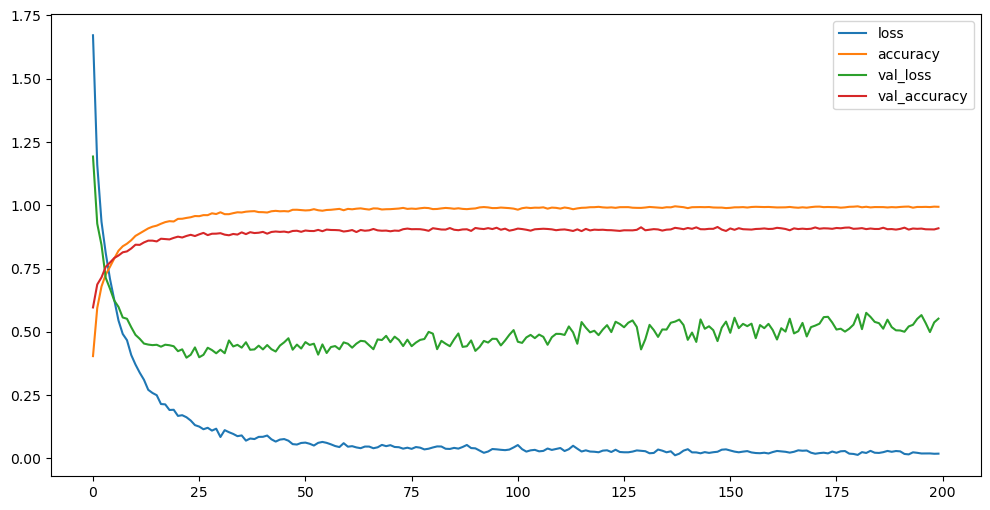

In [413]:
plotValidate(model_history)

## Model Evaluation

In [372]:
test_loss,test_acc=model.evaluate(X_test,Y_test,batch_size=128)
print("The test loss is ",test_loss)
print("The best accuracy is: ",test_acc*100)

26/26 [==============================] - 0s 2ms/step - loss: 0.5555 - accuracy: 0.9169
The test loss is  0.5555127263069153
The best accuracy is:  91.68941378593445


In [373]:
def select_class(mylist=[]):
    if mylist==[]:
        return None
    
    max_item = 0.0
    num_item = 0
    for i in range(len(mylist)):
        if max_item <= mylist[i]:
            max_item = mylist[i]
            num_item = i
    return num_item

def pred_from_name(mylistlist):
    dig_list_name = []
    for list in mylistlist:
        dig_list_name.append(select_class(list))

    return dig_list_name



from sklearn import preprocessing
pred1 = model.predict(X_test)

print(pred1)

pred = list(pred1)


104/104 [==============================] - 0s 1ms/step
[[6.4021799e-10 1.0000000e+00 1.4719684e-11 ... 8.7063710e-11
  7.1718895e-11 5.4825366e-09]
 [1.9524671e-03 1.7773515e-05 5.4363105e-03 ... 8.4866524e-06
  1.3020117e-04 9.9213493e-01]
 [2.1822377e-09 1.1015581e-11 3.1655439e-11 ... 7.7487412e-09
  6.9734978e-09 1.0000000e+00]
 ...
 [3.1846531e-13 1.0404093e-18 9.8639909e-15 ... 8.0310894e-16
  1.0000000e+00 2.5393185e-16]
 [4.9149366e-20 1.0131230e-32 5.6745133e-30 ... 4.7937774e-36
  1.3663539e-29 4.8380653e-23]
 [2.1301458e-09 3.1824522e-11 1.0000000e+00 ... 1.1002426e-09
  1.7803799e-10 9.3470287e-10]]


In [374]:
dig_name_list = pred_from_name(pred1)
print(dig_name_list)

[1, 9, 9, 9, 5, 7, 2, 1, 1, 9, 3, 0, 1, 8, 0, 3, 0, 2, 0, 5, 7, 4, 7, 0, 8, 0, 0, 8, 5, 0, 1, 9, 1, 6, 7, 4, 7, 6, 7, 8, 6, 6, 8, 5, 4, 5, 4, 8, 4, 0, 4, 1, 7, 6, 2, 8, 8, 6, 0, 2, 4, 9, 9, 0, 7, 1, 2, 3, 2, 7, 9, 9, 2, 5, 5, 4, 1, 8, 1, 8, 5, 2, 2, 4, 2, 0, 4, 4, 6, 2, 2, 6, 4, 6, 6, 4, 2, 1, 5, 0, 5, 7, 6, 2, 4, 0, 8, 7, 3, 5, 5, 8, 3, 3, 7, 4, 0, 7, 0, 3, 5, 4, 0, 6, 4, 9, 4, 2, 3, 8, 4, 6, 6, 0, 8, 4, 0, 5, 7, 9, 0, 0, 5, 7, 9, 4, 2, 7, 2, 8, 8, 4, 5, 5, 3, 9, 6, 4, 9, 0, 7, 9, 1, 8, 7, 5, 0, 7, 9, 3, 0, 4, 8, 0, 2, 6, 0, 9, 8, 0, 6, 4, 3, 4, 4, 9, 7, 1, 3, 4, 8, 5, 0, 3, 8, 9, 9, 9, 7, 0, 7, 6, 4, 7, 2, 9, 8, 8, 8, 1, 6, 9, 2, 7, 4, 2, 9, 4, 8, 9, 4, 7, 5, 8, 8, 3, 5, 1, 7, 8, 8, 3, 3, 8, 0, 8, 1, 6, 9, 8, 9, 9, 8, 2, 0, 4, 4, 6, 0, 1, 3, 8, 5, 3, 9, 3, 2, 7, 8, 9, 6, 0, 2, 5, 0, 5, 9, 5, 4, 5, 7, 5, 9, 9, 7, 5, 6, 8, 9, 8, 5, 3, 5, 5, 7, 7, 7, 2, 3, 3, 9, 2, 2, 2, 3, 0, 4, 0, 1, 3, 5, 1, 1, 3, 8, 4, 4, 1, 7, 0, 2, 3, 6, 4, 0, 7, 4, 3, 3, 9, 9, 0, 3, 0, 9, 4, 9, 8, 5, 5, 5, 1, 9, 

C:\Users\Dude\AppData\Local\Temp\ipykernel_18124\1955635415.py:2: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if mylist==[]:


In [375]:
pred1 = model.predict(X_test)

precision = tf.keras.metrics.Precision()
precision.update_state(Y_test, dig_name_list)

precision_num = precision.result().numpy()
print("precision: ", precision_num)

104/104 [==============================] - 0s 1ms/step
precision:  0.9904794


In [376]:
recall = tf.keras.metrics.Recall()
recall.update_state(Y_test, dig_name_list)

recall_num = recall.result().numpy()
print("recall: ", recall_num)

recall:  0.98846287


In [377]:
# or F1 score:
F1_score = 2 * ( precision_num * recall_num ) / ( precision_num+recall_num )
print("F1_score: ", F1_score)

F1_score:  0.9894701212386008


In [378]:
print(converter.inverse_transform(dig_name_list))
print(converter.inverse_transform(Y_test))

['classical' 'rock' 'rock' ... 'reggae' 'metal' 'country']
['classical' 'rock' 'rock' ... 'reggae' 'metal' 'country']


In [379]:
def metrics(list_pred, list_real):
    if len(list_pred) != len(list_real):
        print( "len(list_pred) ", len(list_pred)," len(list_real) ", len(list_real))
        print( "Длины списков не равны" )
        return False
    
    true_class = 0
    false_class = 0

    for i in range(len(list_pred)):
        if list_pred[i] == list_real[i]:
            true_class+=1
    similarity_res = true_class/len(list_pred)
    print("similarity_res ", similarity_res)

    return True


metrics(dig_name_list, Y_test)


similarity_res  0.9168941461935093


True

In [380]:
song_name_3_sec = 'metal.00006.0.wav' # разбиение на названия в датасете на 3 сек и на 30 разные

# df_30_sec = pd.read_csv("gtzan/features_30_sec.csv")


song_data = df_with_filename[df_with_filename['filename'] == song_name_3_sec]

song_data_idx = df_with_filename[df_with_filename['filename'] == song_name_3_sec].index
print("song_data_idx ",song_data_idx)


song_data_idx  Int64Index([6052], dtype='int64')


In [381]:
df_with_filename[df_with_filename['filename'] == song_name_3_sec]

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
6052,metal.00006.0.wav,66149,0.337009,0.081228,0.04814,0.000066,2952.297583,121514.907901,2544.664385,73528.976978,...,34.350174,-14.89377,28.804266,2.277572,74.748886,-2.875479,57.728088,6.461823,88.149628,metal


In [382]:
pred_song = model.predict(X[song_data_idx])
print(pred_song)
dig_name_list_pred_song = pred_from_name(pred_song)
print(dig_name_list_pred_song)
print(converter.inverse_transform(dig_name_list_pred_song))

1/1 [==============================] - 0s 16ms/step
[[8.0034313e-11 6.2147337e-16 1.5506171e-13 7.5390506e-14 8.0579369e-13
  1.8317904e-14 1.0000000e+00 1.3285639e-17 2.0996202e-15 8.6965110e-15]]
[6]
['metal']


C:\Users\Dude\AppData\Local\Temp\ipykernel_18124\1955635415.py:2: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if mylist==[]:


In [383]:

sim_songs = songs_similarity(song_name_3_sec, features_scaled)
print(sim_songs.to_string())

filename
metal.00006.2.wav        0.268928
metal.00006.1.wav        0.311855
metal.00006.9.wav        0.338054
metal.00006.3.wav        0.358067
metal.00006.4.wav        0.367362
metal.00006.8.wav        0.383419
metal.00006.7.wav        0.398939
disco.00097.0.wav        0.421798
metal.00006.5.wav        0.422546
disco.00071.4.wav        0.429283
classical.00091.8.wav    0.431030
disco.00097.5.wav        0.437018
disco.00048.2.wav        0.442989
classical.00091.9.wav    0.443696
metal.00014.0.wav        0.445427
disco.00097.8.wav        0.447461
metal.00001.2.wav        0.449385
disco.00097.9.wav        0.460362
disco.00071.5.wav        0.468790
blues.00071.2.wav        0.475382
blues.00068.8.wav        0.479191
metal.00006.6.wav        0.479802
disco.00097.6.wav        0.480481
disco.00097.7.wav        0.480788
disco.00097.1.wav        0.481013
disco.00067.6.wav        0.485922
disco.00097.4.wav        0.491226
blues.00068.9.wav        0.491362
classical.00091.6.wav    0.493699
blues

In [384]:
# converter.inverse_transform(int_mylist(pred))
# print(converter.inverse_transform([select_class(pred)]))

def ranging_dataframe(song_name_3_sec, sim_songs):
    list_word = song_name_3_sec.split('.')
    # print(list_word)
    for i in range(1,10):
        del_song = list_word[0]+'.'+list_word[1]+'.'+ str(i) +'.'+list_word[3]
        # print(del_song)
        sim_songs = sim_songs.drop(labels = del_song)
        # sim_songs = sim_songs.loc[sim_songs[filename] !=  del_song]
    return sim_songs

sim_songs = ranging_dataframe(song_name_3_sec, sim_songs)


In [385]:
print(sim_songs.to_string())

filename
disco.00097.0.wav        0.421798
disco.00071.4.wav        0.429283
classical.00091.8.wav    0.431030
disco.00097.5.wav        0.437018
disco.00048.2.wav        0.442989
classical.00091.9.wav    0.443696
metal.00014.0.wav        0.445427
disco.00097.8.wav        0.447461
metal.00001.2.wav        0.449385
disco.00097.9.wav        0.460362
disco.00071.5.wav        0.468790
blues.00071.2.wav        0.475382
blues.00068.8.wav        0.479191
disco.00097.6.wav        0.480481
disco.00097.7.wav        0.480788
disco.00097.1.wav        0.481013
disco.00067.6.wav        0.485922
disco.00097.4.wav        0.491226
blues.00068.9.wav        0.491362
classical.00091.6.wav    0.493699
blues.00071.4.wav        0.495209
blues.00071.3.wav        0.495367
disco.00097.2.wav        0.496250
jazz.00023.7.wav         0.497670
metal.00004.7.wav        0.497865
blues.00068.4.wav        0.497960
disco.00067.5.wav        0.498867
metal.00001.3.wav        0.498878
disco.00072.0.wav        0.499058
metal

In [386]:
list_name_song = song_name_3_sec.split('.')

sim_songs_idx = sim_songs.index

dict_score = {}
for item in sim_songs_idx:
    if list_name_song[0] in item:
        dict_score[item] = sim_songs[item]
    

print(dict_score)

data_frame_score = pd.DataFrame(dict_score.items())
print(data_frame_score)


{'metal.00014.0.wav': 0.44542712298919174, 'metal.00001.2.wav': 0.44938496072697875, 'metal.00004.7.wav': 0.49786508265536633, 'metal.00001.3.wav': 0.4988784902176524, 'metal.00086.8.wav': 0.5004259074404231, 'metal.00036.0.wav': 0.5037340616978947, 'metal.00007.8.wav': 0.5041916452543587, 'metal.00001.9.wav': 0.5043277497617976, 'metal.00086.6.wav': 0.5099393196395092, 'metal.00007.6.wav': 0.5104355813564821, 'metal.00007.7.wav': 0.5130535471893756, 'metal.00070.9.wav': 0.5130735400639227, 'metal.00004.0.wav': 0.5141775853133894, 'metal.00001.1.wav': 0.5155431540221884, 'metal.00036.1.wav': 0.5174812114484316, 'metal.00037.3.wav': 0.5180138104802736, 'metal.00014.1.wav': 0.5180615333689036, 'metal.00001.7.wav': 0.5182027407468726, 'metal.00007.9.wav': 0.5194005491209774, 'metal.00029.8.wav': 0.5209773034530514, 'metal.00001.0.wav': 0.5236667914992057, 'metal.00014.3.wav': 0.5239254516303224, 'metal.00007.2.wav': 0.5245687045081925, 'metal.00047.3.wav': 0.5268054527499393, 'metal.00037

In [387]:
print(pd.DataFrame.from_dict(dict_score.items()).to_string())

                     0         1
0    metal.00014.0.wav  0.445427
1    metal.00001.2.wav  0.449385
2    metal.00004.7.wav  0.497865
3    metal.00001.3.wav  0.498878
4    metal.00086.8.wav  0.500426
5    metal.00036.0.wav  0.503734
6    metal.00007.8.wav  0.504192
7    metal.00001.9.wav  0.504328
8    metal.00086.6.wav  0.509939
9    metal.00007.6.wav  0.510436
10   metal.00007.7.wav  0.513054
11   metal.00070.9.wav  0.513074
12   metal.00004.0.wav  0.514178
13   metal.00001.1.wav  0.515543
14   metal.00036.1.wav  0.517481
15   metal.00037.3.wav  0.518014
16   metal.00014.1.wav  0.518062
17   metal.00001.7.wav  0.518203
18   metal.00007.9.wav  0.519401
19   metal.00029.8.wav  0.520977
20   metal.00001.0.wav  0.523667
21   metal.00014.3.wav  0.523925
22   metal.00007.2.wav  0.524569
23   metal.00047.3.wav  0.526805
24   metal.00037.7.wav  0.526972
25   metal.00000.1.wav  0.527527
26   metal.00007.3.wav  0.531600
27   metal.00036.3.wav  0.533861
28   metal.00004.8.wav  0.534335
29   metal

## Тестирование на датасете с 30 сек муз треками

In [388]:
song_name_30_sec = 'metal.00006.wav' # разбиение на названия в датасете на 3 сек и на 30 разные

df_30_sec = pd.read_csv("gtzan/features_30_sec.csv")


song_data = df_30_sec[df_30_sec['filename'] == song_name_3_sec]

song_data_idx = df_30_sec[df_30_sec['filename'] == song_name_3_sec].index
print("song_data_idx ",song_data_idx)

song_data_idx  Int64Index([], dtype='int64')


In [389]:
df_30_sec_with_labels = df_30_sec
df_30_sec=df_30_sec.drop(labels="filename",axis=1)
class_list=df_30_sec.iloc[:,-1]
converter=LabelEncoder()
converter.fit(class_list)
Y=converter.transform(class_list)
# print(class_list)
# print(Y)
# print(list(converter.inverse_transform(Y)))

In [390]:
from sklearn.preprocessing import StandardScaler
fit=StandardScaler()
X=fit.fit_transform(np.array(df_30_sec.iloc[:,:-1],dtype=float))

In [391]:
df_30_sec_with_labels[df_30_sec_with_labels['filename'] == song_name_30_sec]

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
606,metal.00006.wav,661504,0.434033,0.080115,0.050472,0.000103,3236.92534,346654.865448,2572.749034,73955.590892,...,54.096462,-12.473878,56.19677,6.361197,54.97327,-3.853356,51.176369,4.722446,54.393253,metal


In [392]:
# pred_song = model.predict(X[song_data_idx])
# print(pred_song)
# dig_name_list_pred_song = pred_from_name(pred_song)
# print(dig_name_list_pred_song)
# print(converter.inverse_transform(dig_name_list_pred_song))

ValueError: Unexpected result of `predict_function` (Empty batch_outputs). Please use `Model.compile(..., run_eagerly=True)`, or `tf.config.run_functions_eagerly(True)` for more information of where went wrong, or file a issue/bug to `tf.keras`.

In [408]:
def songs_similarity(song_name, features, metric='cosine'):
    distances = cdist(features, features, metric=metric)
    dist_df1 = pd.DataFrame(distances)
    dist_df1 = dist_df1.set_index(df_30_sec_with_labels.filename)
    dist_df1.columns = df_30_sec_with_labels.filename
    series = dist_df1[song_name].sort_values(ascending = True)
    series = series.drop(song_name)
    return series

# print(audio_path+song_name.split('.')[0]+'/'+song_name)
features = df_30_sec_with_labels.iloc[:,2:-1]
features_scaled=preprocessing.scale(features)

# features.describe().T

song_name_30_sec = 'blues.00001.wav' # разбиение на названия в датасете на 3 сек и на 30 разные 


sim_songs = songs_similarity(song_name_30_sec, features_scaled)
print(sim_songs.to_string())


# df_30_sec_with_labels

filename
rock.00014.wav         0.315839
reggae.00006.wav       0.326132
hiphop.00002.wav       0.327233
reggae.00036.wav       0.338581
blues.00092.wav        0.342017
reggae.00009.wav       0.345063
reggae.00025.wav       0.347027
reggae.00038.wav       0.347655
reggae.00008.wav       0.359180
country.00078.wav      0.365239
country.00052.wav      0.371913
reggae.00035.wav       0.374332
country.00060.wav      0.380966
reggae.00002.wav       0.387045
reggae.00014.wav       0.388057
reggae.00033.wav       0.392030
country.00085.wav      0.414753
reggae.00013.wav       0.420258
rock.00003.wav         0.421918
reggae.00007.wav       0.425850
hiphop.00081.wav       0.434468
country.00067.wav      0.434989
reggae.00020.wav       0.437543
blues.00090.wav        0.439221
blues.00086.wav        0.445401
rock.00066.wav         0.445531
reggae.00019.wav       0.447167
reggae.00004.wav       0.452877
rock.00012.wav         0.454779
reggae.00037.wav       0.458812
blues.00091.wav        0.461436

In [410]:
import IPython.display as ipd
audio_path = 'gtzan/genres_original/'
song_name = 'blues.00001.wav'
ipd.Audio(audio_path+song_name.split('.')[0]+'/'+song_name)


In [411]:

import IPython.display as ipd
audio_path = 'gtzan/genres_original/'
song_name = 'disco.00014.wav'
ipd.Audio(audio_path+song_name.split('.')[0]+'/'+song_name)

In [403]:
distances = cdist(X, X, 'correlation') #cosine correlation

dist_df = pd.DataFrame(distances)
dist_df = dist_df.set_index(df_30_sec_with_labels.filename)
dist_df.columns = df_30_sec_with_labels.filename
dist_df

filename,blues.00000.wav,blues.00001.wav,blues.00002.wav,blues.00003.wav,blues.00004.wav,blues.00005.wav,blues.00006.wav,blues.00007.wav,blues.00008.wav,blues.00009.wav,...,rock.00090.wav,rock.00091.wav,rock.00092.wav,rock.00093.wav,rock.00094.wav,rock.00095.wav,rock.00096.wav,rock.00097.wav,rock.00098.wav,rock.00099.wav
filename,,,,,,,,,,,,,,,,,,,,,
blues.00000.wav,0.000000,0.832672,0.514701,0.768166,1.161460,1.374481,1.222693,1.203507,0.428918,1.074183,...,1.041464,0.569803,0.573634,0.451601,0.565776,5.112510e-01,4.804023e-01,0.674151,8.068584e-01,0.734823
blues.00001.wav,0.832672,0.000000,1.000156,0.417319,0.827901,0.690321,0.683653,0.567598,0.777416,0.600115,...,1.122721,1.262096,1.311100,1.079514,1.261368,9.526537e-01,1.120933e+00,1.224938,4.098152e-01,0.641693
blues.00002.wav,0.514701,1.000156,0.000000,0.853081,0.712565,1.078188,1.008225,0.898819,0.639076,1.113239,...,0.984789,0.551157,0.556242,0.563614,0.642457,6.650752e-01,5.836122e-01,0.546371,8.866517e-01,0.715740
blues.00003.wav,0.768166,0.417319,0.853081,0.000000,0.932495,0.857727,0.685314,0.675503,0.687509,0.685981,...,1.308025,1.328572,1.343416,1.087240,1.331453,1.119287e+00,1.110241e+00,1.262105,5.207436e-01,0.840230
blues.00004.wav,1.161460,0.827901,0.712565,0.932495,0.000000,0.394407,0.465901,0.344484,1.120642,0.467314,...,0.866729,1.172305,1.115171,1.150984,1.295713,1.165642e+00,1.197479e+00,1.040373,9.342649e-01,0.993375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rock.00095.wav,0.511251,0.952654,0.665075,1.119287,1.165642,1.257782,1.269659,1.235643,0.466593,1.263164,...,0.905342,0.201226,0.218398,0.204333,0.211810,1.110223e-16,1.421272e-01,0.194763,7.449401e-01,0.472710
rock.00096.wav,0.480402,1.120933,0.583612,1.110241,1.197479,1.318872,1.329112,1.342247,0.478841,1.328121,...,0.966838,0.159901,0.185364,0.187214,0.201804,1.421272e-01,1.110223e-16,0.147923,7.667866e-01,0.522704
rock.00097.wav,0.674151,1.224938,0.546371,1.262105,1.040373,1.195949,1.215889,1.212125,0.676499,1.354658,...,0.939067,0.103875,0.111353,0.155662,0.176396,1.947632e-01,1.479231e-01,0.000000,8.279393e-01,0.598321


In [404]:
print(dist_df.to_string())

filename             blues.00000.wav  blues.00001.wav  blues.00002.wav  blues.00003.wav  blues.00004.wav  blues.00005.wav  blues.00006.wav  blues.00007.wav  blues.00008.wav  blues.00009.wav  blues.00010.wav  blues.00011.wav  blues.00012.wav  blues.00013.wav  blues.00014.wav  blues.00015.wav  blues.00016.wav  blues.00017.wav  blues.00018.wav  blues.00019.wav  blues.00020.wav  blues.00021.wav  blues.00022.wav  blues.00023.wav  blues.00024.wav  blues.00025.wav  blues.00026.wav  blues.00027.wav  blues.00028.wav  blues.00029.wav  blues.00030.wav  blues.00031.wav  blues.00032.wav  blues.00033.wav  blues.00034.wav  blues.00035.wav  blues.00036.wav  blues.00037.wav  blues.00038.wav  blues.00039.wav  blues.00040.wav  blues.00041.wav  blues.00042.wav  blues.00043.wav  blues.00044.wav  blues.00045.wav  blues.00046.wav  blues.00047.wav  blues.00048.wav  blues.00049.wav  blues.00050.wav  blues.00051.wav  blues.00052.wav  blues.00053.wav  blues.00054.wav  blues.00055.wav  blues.00056.wav  blues.0005